## **Gradient Boosting in Regards to Heart Disease Classification, plus SHAP Visualisation for explaining the Models Nature**
*Group 10* <br>
*08/12/2025*

### **Data Preparation and Import**

Required external pip imports will be retrieved and downloaded in the below pip install code cell for the notebook requirments to be resolved.

In [51]:
%pip install pandas pd numpy scikit-learn matplotlib seaborn kagglehub shap xgboost lightgbm dask dask-ml distributed ipywidgets 

Note: you may need to restart the kernel to use updated packages.


Now the notebook will import the downloaded pip modules ensuring they can be linked, retrieved and used globally in the notebook.

In [ ]:
import numpy as np # for performing more advanced operations on arrays, such as converting the heart disease dataset columns to float64 and int64 respectively as well as creating partions from the x training set
import pandas as pd # for converting the heart disease dataset to a more robustly interfacable pandas dataframe array for working with the various ML Models and helper methods
import matplotlib.pyplot as plt # plotting roc scores et al of the gradient boosting models
import seaborn as sns # for heatmap plotting the correlation matrix of the models

import kagglehub # for retrieving and downloading the heart disease dataset from kaggle

# Gradient Boosting Models
import xgboost as xgb # the xgboost model
import lightgbm as lgb # the lightgbm model

import time # for measuring inference time of the models
from math import pi # for computing pie angles in evaluation plots

# SHAP 
import shap # explaining how the two gradient boosting models made their predictions, i.e. feature importance in regards to the two grad boost models created deeper within this notebook

# Scikit Learn Methods
from sklearn.preprocessing import StandardScaler # for scaling the heart disease dataset features
from sklearn.model_selection import train_test_split # for splitting the heart disease dataset into training, testing and validation sets
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score  # for getting the scores, precision, recall, accuracy and f1 scores for evaulating the different metric scores for each model
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score # for generating model classification reports, confusion matrices and roc auc scores
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV # for selecting best hyperparameters for the gradient boosting models, both using 10 fold cross validation
from sklearn.linear_model import LogisticRegression # for copmaring against the tree shap explanations 
from sklearn.metrics import roc_curve, auc # for plotting each of the models roc curves and auc scores

# Dask for distributed learning of the LightGBM model
from dask.distributed import Client # contructing the dask client for distributed learning
from dask_ml.model_selection import GridSearchCV as DaskGridSearchCV # selecting best hyperparameters for the LightGBM model using dask distributed learning
import dask.array as da # data collection for the dask distributed learning client

import warnings # hiding warnings to clean up evaluation output

warnings.filterwarnings('ignore') # filter out any warnings in the notebook cell outputs

### **Data Exploration**

In [53]:
path = kagglehub.dataset_download("redwankarimsony/heart-disease-data") # get path to downloaded kaggle heart disease dataset files

print("Path to kaggle files:", path) # output to user that path

Path to kaggle files: /Users/sandymacdonald/.cache/kagglehub/datasets/redwankarimsony/heart-disease-data/versions/6


In [54]:
heart_data = path + "/heart_disease_uci.csv" # retrieve the dataset by appending the filename to the enclosing path

In [55]:
heart_disease_df = pd.read_csv(heart_data) #convert heart disease csv data to a pandas dataframe

In [56]:
print("Heart Disease Dataset before Preprocessing:")
heart_disease_df.head() # head the dataset to see that it has been converted to a pandas dataframe successfully

Heart Disease Dataset before Preprocessing:


,id,age,sex,dataset,cp,trestbps,chol,fbs,restecg,thalch,exang,oldpeak,slope,ca,thal,num
0,1,63,Male,Cleveland,typical angina,145.0,233.0,True,lv hypertrophy,150.0,False,2.3,downsloping,0.0,fixed defect,0
1,2,67,Male,Cleveland,asymptomatic,160.0,286.0,False,lv hypertrophy,108.0,True,1.5,flat,3.0,normal,2
2,3,67,Male,Cleveland,asymptomatic,120.0,229.0,False,lv hypertrophy,129.0,True,2.6,flat,2.0,reversable defect,1
3,4,37,Male,Cleveland,non-anginal,130.0,250.0,False,normal,187.0,False,3.5,downsloping,0.0,normal,0
4,5,41,Female,Cleveland,atypical angina,130.0,204.0,False,lv hypertrophy,172.0,False,1.4,upsloping,0.0,normal,0


In [57]:
heart_disease_df.shape # get rows and columns size of the heart disease dataset 

(920, 16)

In [58]:
# Binarisation of the Target 'Num' Feature
heart_disease_df["num"] = heart_disease_df["num"].apply(lambda x: 1 if x > 0 else 0) # make target num feature binary, either true 1 or 0 

In [59]:
print("Heart Disease Dataset after Target Binarisation:")
heart_disease_df.head() # show newly binarised target feature has been applied successfully

Heart Disease Dataset after Target Binarisation:


,id,age,sex,dataset,cp,trestbps,chol,fbs,restecg,thalch,exang,oldpeak,slope,ca,thal,num
0,1,63,Male,Cleveland,typical angina,145.0,233.0,True,lv hypertrophy,150.0,False,2.3,downsloping,0.0,fixed defect,0
1,2,67,Male,Cleveland,asymptomatic,160.0,286.0,False,lv hypertrophy,108.0,True,1.5,flat,3.0,normal,1
2,3,67,Male,Cleveland,asymptomatic,120.0,229.0,False,lv hypertrophy,129.0,True,2.6,flat,2.0,reversable defect,1
3,4,37,Male,Cleveland,non-anginal,130.0,250.0,False,normal,187.0,False,3.5,downsloping,0.0,normal,0
4,5,41,Female,Cleveland,atypical angina,130.0,204.0,False,lv hypertrophy,172.0,False,1.4,upsloping,0.0,normal,0


In [60]:
heart_disease_df.info() # output number of columns, along with their names, data type and how many non-null values they contain

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 920 entries, 0 to 919
Data columns (total 16 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   id        920 non-null    int64  
 1   age       920 non-null    int64  
 2   sex       920 non-null    object 
 3   dataset   920 non-null    object 
 4   cp        920 non-null    object 
 5   trestbps  861 non-null    float64
 6   chol      890 non-null    float64
 7   fbs       830 non-null    object 
 8   restecg   918 non-null    object 
 9   thalch    865 non-null    float64
 10  exang     865 non-null    object 
 11  oldpeak   858 non-null    float64
 12  slope     611 non-null    object 
 13  ca        309 non-null    float64
 14  thal      434 non-null    object 
 15  num       920 non-null    int64  
dtypes: float64(5), int64(3), object(8)
memory usage: 115.1+ KB


### **Data Pre-Processing**

In [61]:
heart_disease_df = heart_disease_df.drop(columns=["id"]) # drop index id column as it does not need to be represented 

print("Heart Disease Dataset without ID Column:")
heart_disease_df.head() # show dataset with the dropped id column, notying we still have an index

Heart Disease Dataset without ID Column:


,age,sex,dataset,cp,trestbps,chol,fbs,restecg,thalch,exang,oldpeak,slope,ca,thal,num
0,63,Male,Cleveland,typical angina,145.0,233.0,True,lv hypertrophy,150.0,False,2.3,downsloping,0.0,fixed defect,0
1,67,Male,Cleveland,asymptomatic,160.0,286.0,False,lv hypertrophy,108.0,True,1.5,flat,3.0,normal,1
2,67,Male,Cleveland,asymptomatic,120.0,229.0,False,lv hypertrophy,129.0,True,2.6,flat,2.0,reversable defect,1
3,37,Male,Cleveland,non-anginal,130.0,250.0,False,normal,187.0,False,3.5,downsloping,0.0,normal,0
4,41,Female,Cleveland,atypical angina,130.0,204.0,False,lv hypertrophy,172.0,False,1.4,upsloping,0.0,normal,0


In [62]:
categorical_cols = heart_disease_df.select_dtypes(include=['object']).columns.tolist() # find categorical columns in the dataset by filtering for object data types

print("Categorical Columns in Heart Disease Dataset:")
categorical_cols # output textually the categorical columns found above

Categorical Columns in Heart Disease Dataset:


['sex', 'dataset', 'cp', 'fbs', 'restecg', 'exang', 'slope', 'thal']

In [63]:
heart_disease_df = pd.get_dummies(heart_disease_df, columns=categorical_cols, drop_first=True) # one hot encode the categorical columns found above

In [64]:
print("Missing Values in Each Feature:")
heart_disease_df.isnull().sum() # search for missing values in the heart disease dataset

Missing Values in Each Feature:


age                           0
trestbps                     59
chol                         30
thalch                       55
oldpeak                      62
ca                          611
num                           0
sex_Male                      0
dataset_Hungary               0
dataset_Switzerland           0
dataset_VA Long Beach         0
cp_atypical angina            0
cp_non-anginal                0
cp_typical angina             0
fbs_True                      0
restecg_normal                0
restecg_st-t abnormality      0
exang_True                    0
slope_flat                    0
slope_upsloping               0
thal_normal                   0
thal_reversable defect        0
dtype: int64

In [65]:
missing_threshold = 0.5 # if over half the values in a column are missing, drop the column

for col in heart_disease_df.columns: # iterate through the heart disease  columns
    missing_fraction = heart_disease_df[col].isnull().mean() # compute the fraction of missing values in the column

    if missing_fraction > missing_threshold: # if the missing fraction is greater than the threshold
        heart_disease_df.drop(columns=[col], inplace=True) # drop the column

    else: # if the missing fraction is less than the threshold
        if heart_disease_df[col].dtype in [np.float64, np.int64]: # and if the column is numerical
            heart_disease_df[col] = heart_disease_df[col].fillna(heart_disease_df[col].median()) # fill missing values with the median value of the column

        else: # if the column is categorical
            heart_disease_df[col] = heart_disease_df[col].fillna(heart_disease_df[col].mode()[0]) # fill missing values with the mode value of the column

heart_disease_df.isnull().sum() # now verify that there are no missing values in the heart disease dataset

heart_disease_df.head() # output the cleaned heart disease dataset with no remaining missing values

,age,trestbps,chol,thalch,oldpeak,num,sex_Male,dataset_Hungary,dataset_Switzerland,dataset_VA Long Beach,...,cp_non-anginal,cp_typical angina,fbs_True,restecg_normal,restecg_st-t abnormality,exang_True,slope_flat,slope_upsloping,thal_normal,thal_reversable defect
0,63,145.0,233.0,150.0,2.3,0,True,False,False,False,...,False,True,True,False,False,False,False,False,False,False
1,67,160.0,286.0,108.0,1.5,1,True,False,False,False,...,False,False,False,False,False,True,True,False,True,False
2,67,120.0,229.0,129.0,2.6,1,True,False,False,False,...,False,False,False,False,False,True,True,False,False,True
3,37,130.0,250.0,187.0,3.5,0,True,False,False,False,...,True,False,False,True,False,False,False,False,True,False
4,41,130.0,204.0,172.0,1.4,0,False,False,False,False,...,False,False,False,False,False,False,False,True,True,False


In [66]:
numerical_cols = heart_disease_df.select_dtypes(include=[np.float64, np.int64]).columns.tolist() # get numerical columns by filtering for float64 and int64 data types

numerical_cols.remove("num") # remove the target variable column from the list of numerical columns

scaler = StandardScaler() # apply standard scaling to the numerical columns to bring them to a common scale

heart_disease_df[numerical_cols] = scaler.fit_transform(heart_disease_df[numerical_cols]) # fit and transform the numerical columns using the standard scaler

heart_disease_df.head() # output the heart disease dataset with scaled numerical features

,age,trestbps,chol,thalch,oldpeak,num,sex_Male,dataset_Hungary,dataset_Switzerland,dataset_VA Long Beach,...,cp_non-anginal,cp_typical angina,fbs_True,restecg_normal,restecg_st-t abnormality,exang_True,slope_flat,slope_upsloping,thal_normal,thal_reversable defect
0,1.007386,0.705176,0.303643,0.489727,1.368109,0,True,False,False,False,...,False,True,True,False,False,False,False,False,False,False
1,1.432034,1.518569,0.789967,-1.181478,0.611589,1,True,False,False,False,...,False,False,False,False,False,True,True,False,True,False
2,1.432034,-0.650479,0.266939,-0.345875,1.651804,1,True,False,False,False,...,False,False,False,False,False,True,True,False,False,True
3,-1.752828,-0.108217,0.459634,1.961979,2.502889,0,True,False,False,False,...,True,False,False,True,False,False,False,False,True,False
4,-1.328180,-0.108217,0.037541,1.365120,0.517024,0,False,False,False,False,...,False,False,False,False,False,False,False,True,True,False


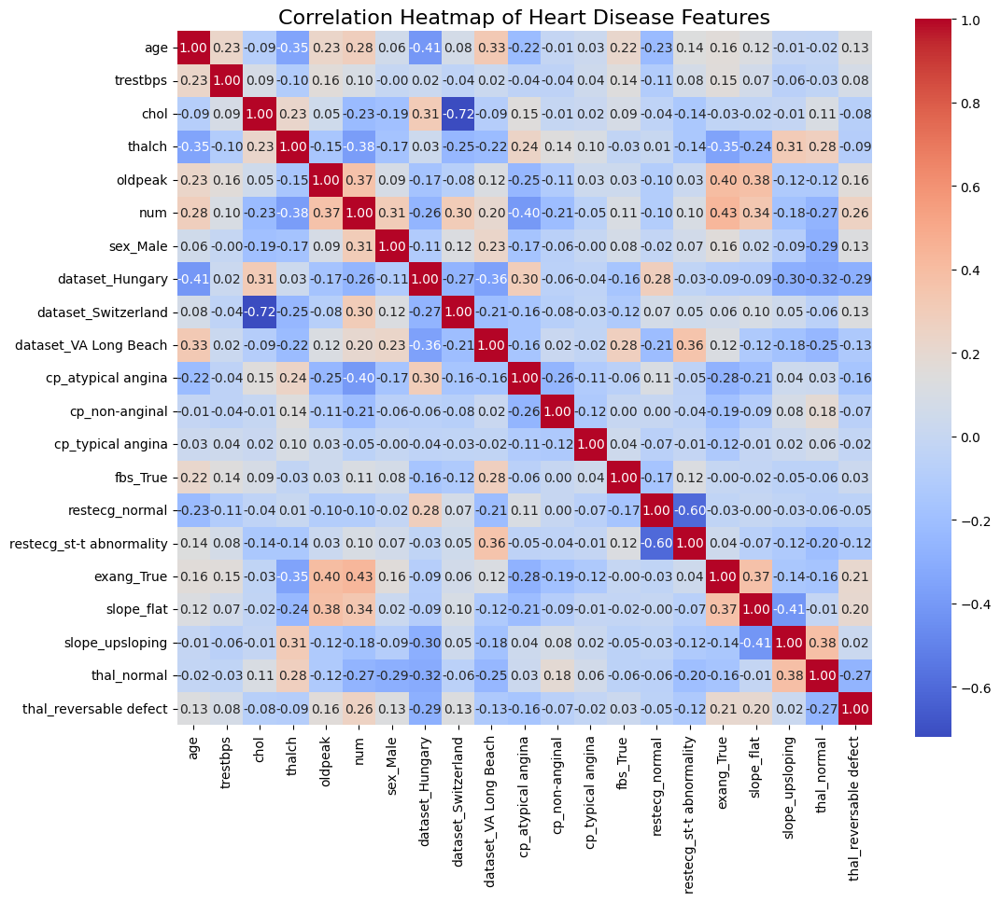

In [ ]:
plt.figure(figsize=(12, 10)) # setup a plot

correlation_matrix = heart_disease_df.corr() # get correlation matrix of the heart disease dataset

sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True) # heatmap plot the correlation matrix

plt.title('Correlation Heatmap of Heart Disease Features', fontsize=16) 

plt.show() # output heatmap plot of the correlation matrix

In [68]:
X = heart_disease_df.drop("num", axis=1) # get the features of heart disease by dropping the target variable column

y = heart_disease_df["num"] # get the target variable column of heart disease

In [69]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=65) # split the heart disease dataset into training and testing sets with an 80-20 split

## **Introducing the Gradient Boosting Models**

### **Training the XGBoost Model**

In [70]:
xgb_clf = xgb.XGBClassifier(eval_metric='logloss', random_state=65) # setup the xgboost classifier model

xgb_clf.fit(X_train, y_train) # train the xgboost classifier model on the training data of the heart disease dataset

,objective,'binary:logistic'
,base_score,None
,booster,None
,callbacks,None
,colsample_bylevel,None
,colsample_bynode,None
,colsample_bytree,None
,device,None
,early_stopping_rounds,None
,enable_categorical,False
,eval_metric,'logloss'


In [71]:
start_time = time.time()
y_pred_xgb = xgb_clf.predict(X_test) # make predictions
inference_time_xgb = time.time() - start_time

print(confusion_matrix(y_test, y_pred_xgb)) # output confusion matrix of the xgboost model

print(classification_report(y_test, y_pred_xgb)) # output classification report of the xgboost model

print('ROC AUC:', roc_auc_score(y_test, y_pred_xgb)) # output ROC AUC score of the xgboost model

[[64 16]
 [21 83]]
              precision    recall  f1-score   support

           0       0.75      0.80      0.78        80
           1       0.84      0.80      0.82       104

    accuracy                           0.80       184
   macro avg       0.80      0.80      0.80       184
weighted avg       0.80      0.80      0.80       184

ROC AUC: 0.7990384615384617


### **Finding Best Hyperparameters for XGBoost**

In [72]:
# XGBoost hyperparameters for grid search
xgb_param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7, 10],
    'learning_rate': [0.01, 0.05, 0.1],
    'subsample': [0.8, 0.9, 1.0],
    'min_child_weight': [1, 3, 5]
}

In [73]:
# setting up xgboost to search the grid in the above cell to find best hyperparameters
xgb_grid = GridSearchCV(xgb.XGBClassifier(random_state=65),
                      xgb_param_grid, # use the custom param grid
                      cv=10, # 10 cross folds validations
                      scoring='roc_auc', # score based on ROC AUC
                      n_jobs=-1, # use every cpu core available
                      verbose=1) # setup the xgboost grid search with 10 fold cross validation to find best hyperparameters from the parameter grid above

xgb_grid.fit(X_train, y_train) # perform the grid search on the training data

print('Best XGBoost Params:', xgb_grid.best_params_) # report back the best hyperparameters found from the grid search
print('Best XGBoost CV ROC AUC:', xgb_grid.best_score_) # report back the best cross-validated ROC AUC score from the grid search

Fitting 10 folds for each of 324 candidates, totalling 3240 fits


/opt/homebrew/Cellar/python@3.11/3.11.14_1/Frameworks/Python.framework/Versions/3.11/lib/python3.11/multiprocessing/queues.py:122: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  return _ForkingPickler.loads(res)
/opt/homebrew/Cellar/python@3.11/3.11.14_1/Frameworks/Python.framework/Versions/3.11/lib/python3.11/multiprocessing/queues.py:122: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  return _ForkingPickler.loads(res)
/opt/homebrew/Cellar/python@3.11/3.11.14_1/Frameworks/Python.framework/Versions/3.11/lib/python3.11/multiprocessing/queues.py:122: UserWarning: pkg_resources is deprecated as an API.

Best XGBoost Params: {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 3, 'n_estimators': 100, 'subsample': 0.8}
Best XGBoost CV ROC AUC: 0.8967278053128126


## **Training a Non-Distributed LightGBM**

In [74]:
lgb_clf = lgb.LGBMClassifier(random_state=65) # setup the lightgbm classifier model

lgb_clf.fit(X_train, y_train) # train the lightgbm classifier model on the training data of the heart disease dataset

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 405, number of negative: 331
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000669 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 370
[LightGBM] [Info] Number of data points in the train set: 736, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.550272 -> initscore=0.201769
[LightGBM] [Info] Start training from score 0.201769
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

,boosting_type,'gbdt'
,num_leaves,31
,max_depth,-1
,learning_rate,0.1
,n_estimators,100
,subsample_for_bin,200000
,objective,None
,class_weight,None
,min_split_gain,0.0
,min_child_weight,0.001
,min_child_samples,20


In [75]:
y_pred_lgb = lgb_clf.predict(X_test) # make predictions

print(confusion_matrix(y_test, y_pred_lgb)) # output confusion matrix of the lightgbm model all using the testing data split

print(classification_report(y_test, y_pred_lgb)) # output the classification report of the lightgbm model

print('ROC AUC:', roc_auc_score(y_test, y_pred_lgb)) # output ROC AUC score of the lightgbm model

[[63 17]
 [19 85]]
              precision    recall  f1-score   support

           0       0.77      0.79      0.78        80
           1       0.83      0.82      0.83       104

    accuracy                           0.80       184
   macro avg       0.80      0.80      0.80       184
weighted avg       0.81      0.80      0.80       184

ROC AUC: 0.8024038461538461


### **Finding Best Hyperparameters for the Non-Distributed LightGBM**

In [76]:
# LightGBM hyperparameter grid for the randomised lgb search using cross validation
lgb_param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [-1, 5, 10],
    'learning_rate': [0.01, 0.05, 0.1],
    'subsample': [0.8, 0.9, 1.0],
    'min_child_samples': [5, 10, 20]
}

In [77]:
# setup the randomised search from the hyperparameters defined in the grid above
lgb_grid = RandomizedSearchCV(
    lgb.LGBMClassifier(random_state=65), # instance the lgbm classifier
    lgb_param_grid, # use the cusotm hyperparameter grid
    n_iter=20, # 20 random search iterations
    cv=10, # use 10 fold cross validation
    scoring='roc_auc', # score based on ROC AUC
    n_jobs=-1, # use every cpu core available
    verbose=1, # output more detailed lgb output
    random_state=65
) # use randomized search cv to find best hyperparameters for lightgbm model for 10 fold cross validation

lgb_grid.fit(X_train, y_train) # perform the randomized search on the training data

print('Best LightGBM Params:', lgb_grid.best_params_)  # output the best hyperparameters found for lightgbm model
print('Best LightGBM CV ROC AUC:', lgb_grid.best_score_) # output the best cross-validated ROC AUC score from the randomized search

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 365, number of negative: 297
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 364, number of negative: 298
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000510 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 357
[LightGBM] [Info] Number of data points in the train set: 662, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.551360 -> initscore=0.206165
[LightGBM] [Info] Start training from score 0.206165
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000603 seconds.
You can set `force_row_wise=true` to remove the overhead.

## **Training a Distributed LightGBM**

In [78]:
# LightGBM with distributed learning using Dask

# setup a dask client for applying distributed learning to the lightgbm model, with 2 workers, hyperthreading and 2GB memory limit per worker
client = Client(n_workers=2, threads_per_worker=2, memory_limit='2GB')

print(client) # output parameters of the dask client

print(f"Dashboard link: {client.dashboard_link}") # output the dashboard link for the dask client

<Client: 'tcp://127.0.0.1:61816' processes=2 threads=4, memory=3.73 GiB>
Dashboard link: http://127.0.0.1:8787/status


In [79]:
# convert training and testing data to dask arrays with appropriate chunk sizes for distributed learning using dask
X_train_dask = da.from_array(X_train.values, chunks=(len(X_train)//2, X_train.shape[1])) # convert X training set to dask array with 2 partitions
y_train_dask = da.from_array(y_train.values, chunks=len(y_train)//2) # convert y training set to dask array with 2 partitions
X_test_dask = da.from_array(X_test.values, chunks=(len(X_test)//2, X_test.shape[1])) # convert X testing set to dask array with 2 partitions

print(f"Training data partitions: {X_train_dask.npartitions}") # output number of partitions in the dask array
print(f"Training data shape: {X_train_dask.shape}") # output shape of the dask array

Training data partitions: 2
Training data shape: (736, 20)


In [80]:
# Train LightGBM with distributed learning
lgb_dist_clf = lgb.LGBMClassifier(
    random_state=65,
    n_jobs=-1  # utilize all available CPU cores
)

lgb_dist_clf.fit(X_train, y_train) # fit on the heart disease training data

y_pred_lgb_dist = lgb_dist_clf.predict(X_test) # make predictions using distrubted LightGBM model

print("LightGBM Distributed Learning Results:") # header for results

print(confusion_matrix(y_test, y_pred_lgb_dist))  # output confusion matrix of the distributed lightgbm model

print(classification_report(y_test, y_pred_lgb_dist)) # output classification report of the distributed lightgbm model

print('ROC AUC:', roc_auc_score(y_test, y_pred_lgb_dist)) # output ROC AUC score of the distributed lightgbm model

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 405, number of negative: 331
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000357 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 370
[LightGBM] [Info] Number of data points in the train set: 736, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.550272 -> initscore=0.201769
[LightGBM] [Info] Start training from score 0.201769
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

### **Finding Best Hyperparameters for the Distributed LightGBM**

In [81]:
lgb_dist_grid = DaskGridSearchCV(
    lgb.LGBMClassifier(random_state=65, n_jobs=1), # instance the lgbm classifier again
    lgb_param_grid, # use the same custom lgb hyperparameter grid
    cv=10, # use 10 cross folds for cross validation
    scoring='roc_auc' # score based on ROC AUC
) # setup dask grid search cv for distributed learning to find best hyperparameters for lightgbm model

lgb_dist_grid.fit(X_train, y_train) # perform the grid search on the training data

print('Best LightGBM Distributed Params:', lgb_dist_grid.best_params_) # output the best hyperparameters found for distributed lightgbm model

print('Best LightGBM Distributed CV ROC AUC:', lgb_dist_grid.best_score_) # output the best cross-validated ROC AUC score from the distributed grid search

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 365, number of negative: 298
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Number of positive: 365, number of negative: 298
[LightGBM] [Info] Total Bins 356
[LightGBM] [Info] Number of data points in the train set: 663, number of used features: 20
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000030 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 354
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.550528 -> initscore=0.202804
[LightGBM] [Info] 

In [82]:
client.close() # close the dask client as we have found best hyperparameters and distributed learning is done

## **Evaluation of Gradient Boosting Model Performance**

In [83]:
# XGBoost evaluation
results = {}

precision_xgb = precision_score(y_test, y_pred_xgb)
recall_xgb = recall_score(y_test, y_pred_xgb)
accuracy_xgb = accuracy_score(y_test, y_pred_xgb)
f1_xgb = f1_score(y_test, y_pred_xgb)
roc_auc_xgb = roc_auc_score(y_test, y_pred_xgb)

results['XGBoost'] = {
    'Precision': precision_xgb,
    'Recall': recall_xgb,
    'Accuracy': accuracy_xgb,
    'F1-Score': f1_xgb,
    'ROC AUC': roc_auc_xgb,
    'Inference Time (s)': inference_time_xgb,
}

print("XGBoost Evaluation")
print("=" * 60)
print(f"Precision:  {precision_xgb:.4f}")
print(f"Recall:     {recall_xgb:.4f}")
print(f"Accuracy:   {accuracy_xgb:.4f}")
print(f"F1-Score:   {f1_xgb:.4f}")
print(f"ROC AUC:    {roc_auc_xgb:.4f}")
print(f"Inference Time: {inference_time_xgb:.4f}s")

XGBoost Evaluation
Precision:  0.8384
Recall:     0.7981
Accuracy:   0.7989
F1-Score:   0.8177
ROC AUC:    0.7990
Inference Time: 0.0019s


In [84]:
# LightGBM (non-distributed) evaluation
print("\n" + "=" * 60)
print("LightGBM (Non-Distributed) Model Evaluation")
print("=" * 60)

start_time = time.time()
y_pred_lgb = lgb_clf.predict(X_test)
inference_time_lgb = time.time() - start_time

precision_lgb = precision_score(y_test, y_pred_lgb)
recall_lgb = recall_score(y_test, y_pred_lgb)
accuracy_lgb = accuracy_score(y_test, y_pred_lgb)
f1_lgb = f1_score(y_test, y_pred_lgb)
roc_auc_lgb = roc_auc_score(y_test, y_pred_lgb)

results['LightGBM'] = {
    'Precision': precision_lgb,
    'Recall': recall_lgb,
    'Accuracy': accuracy_lgb,
    'F1-Score': f1_lgb,
    'ROC AUC': roc_auc_lgb,
    'Inference Time (s)': inference_time_lgb,
}

print(f"Precision:  {precision_lgb:.4f}")
print(f"Recall:     {recall_lgb:.4f}")
print(f"Accuracy:   {accuracy_lgb:.4f}")
print(f"F1-Score:   {f1_lgb:.4f}")
print(f"ROC AUC:    {roc_auc_lgb:.4f}")
print(f"Inference Time: {inference_time_lgb:.4f}s")


LightGBM (Non-Distributed) Model Evaluation
Precision:  0.8333
Recall:     0.8173
Accuracy:   0.8043
F1-Score:   0.8252
ROC AUC:    0.8024
Inference Time: 0.0013s


In [85]:
# LightGBM (distributed) evaluation
print("\n" + "=" * 60)
print("LightGBM (Distributed) Model Evaluation")
print("=" * 60)

start_time = time.time()
y_pred_lgb_dist = lgb_dist_clf.predict(X_test)
inference_time_lgb_dist = time.time() - start_time

precision_lgb_dist = precision_score(y_test, y_pred_lgb_dist)
recall_lgb_dist = recall_score(y_test, y_pred_lgb_dist)
accuracy_lgb_dist = accuracy_score(y_test, y_pred_lgb_dist)
f1_lgb_dist = f1_score(y_test, y_pred_lgb_dist)
roc_auc_lgb_dist = roc_auc_score(y_test, y_pred_lgb_dist)

results['LightGBM Distributed'] = {
    'Precision': precision_lgb_dist,
    'Recall': recall_lgb_dist,
    'Accuracy': accuracy_lgb_dist,
    'F1-Score': f1_lgb_dist,
    'ROC AUC': roc_auc_lgb_dist,
    'Inference Time (s)': inference_time_lgb_dist,
}

print(f"Precision:  {precision_lgb_dist:.4f}")
print(f"Recall:     {recall_lgb_dist:.4f}")
print(f"Accuracy:   {accuracy_lgb_dist:.4f}")
print(f"F1-Score:   {f1_lgb_dist:.4f}")
print(f"ROC AUC:    {roc_auc_lgb_dist:.4f}")
print(f"Inference Time: {inference_time_lgb_dist:.4f}s")


LightGBM (Distributed) Model Evaluation
Precision:  0.8333
Recall:     0.8173
Accuracy:   0.8043
F1-Score:   0.8252
ROC AUC:    0.8024
Inference Time: 0.0013s


In [86]:
# Results table
print("\n" + "=" * 60)
print("Comprehensive Model Comparison Table")
print("=" * 60)

results_df = pd.DataFrame(results).T
metrics = ['Precision', 'Recall', 'Accuracy', 'F1-Score', 'ROC AUC']

print(results_df.to_string())


Comprehensive Model Comparison Table
                      Precision    Recall  Accuracy  F1-Score   ROC AUC  Inference Time (s)
XGBoost                0.838384  0.798077  0.798913  0.817734  0.799038            0.001890
LightGBM               0.833333  0.817308  0.804348  0.825243  0.802404            0.001315
LightGBM Distributed   0.833333  0.817308  0.804348  0.825243  0.802404            0.001272


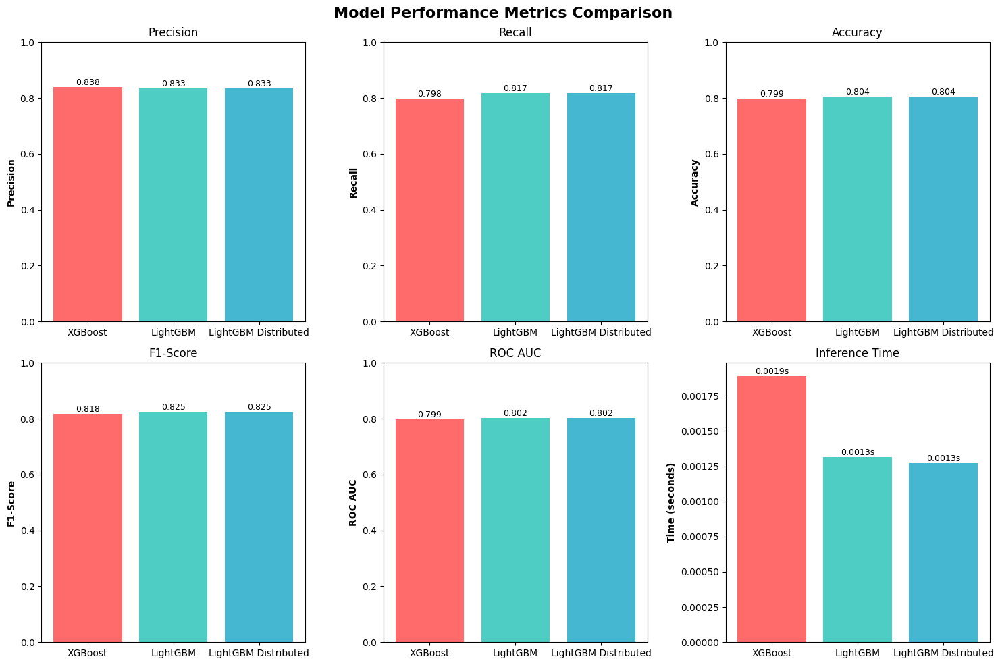

In [87]:
# Metrics bar chart + inference time
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Model Performance Metrics Comparison', fontsize=16, fontweight='bold')

colors = ['#FF6B6B', '#4ECDC4', '#45B7D1']

for idx, metric in enumerate(metrics):
    ax = axes[idx // 3, idx % 3]
    values = [results[model][metric] for model in results.keys()]
    bars = ax.bar(results.keys(), values, color=colors)

    ax.set_ylabel(metric, fontweight='bold')
    ax.set_ylim([0, 1.0])
    ax.set_title(metric)

    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2.0, height, f'{height:.3f}',
        ha='center', va='bottom', fontsize=9)

ax = axes[1, 2]
inference_times = [results[model]['Inference Time (s)'] for model in results.keys()]
bars = ax.bar(results.keys(), inference_times, color=colors)

ax.set_ylabel('Time (seconds)', fontweight='bold')
ax.set_title('Inference Time')

for bar in bars:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width() / 2.0, height, f'{height:.4f}s',
    ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()

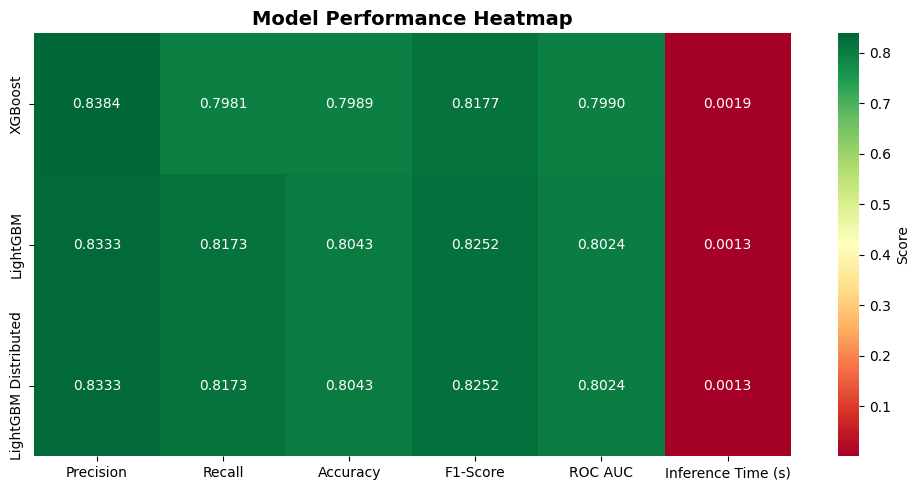

In [88]:
# Heatmap of all metrics
fig, ax = plt.subplots(figsize=(10, 5))
sns.heatmap(results_df, annot=True, fmt='.4f', cmap='RdYlGn', cbar_kws={'label': 'Score'}, ax=ax)

ax.set_title('Model Performance Heatmap', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()

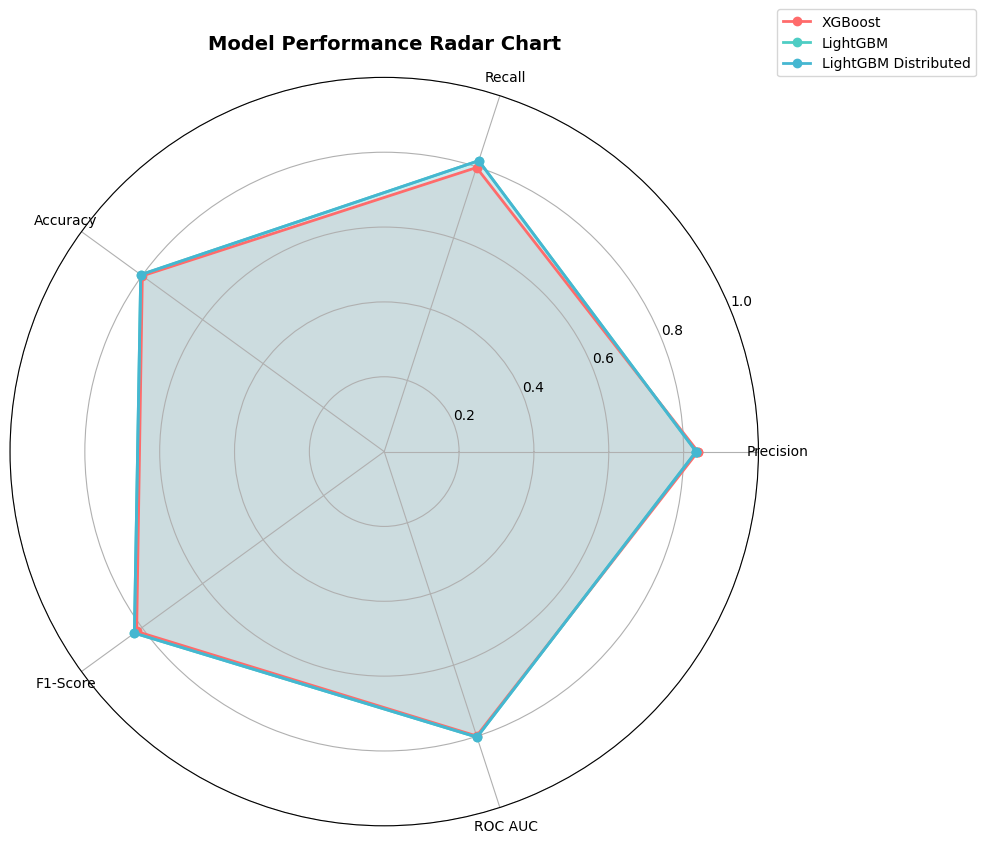

In [89]:
# Radar chart comparison
categories = ['Precision', 'Recall', 'Accuracy', 'F1-Score', 'ROC AUC']
angles = [n / float(len(categories)) * 2 * pi for n in range(len(categories))]
angles += angles[:1]

fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(projection='polar'))

colors_radar = ['#FF6B6B', '#4ECDC4', '#45B7D1']

for idx, model in enumerate(results.keys()):
    values = [results[model][cat] for cat in categories]
    values += values[:1]
    
    ax.plot(angles, values, 'o-', linewidth=2, label=model, color=colors_radar[idx])
    ax.fill(angles, values, alpha=0.15, color=colors_radar[idx])

ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
ax.set_ylim(0, 1)
ax.set_title('Model Performance Radar Chart', fontsize=14, fontweight='bold', pad=20)
ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
ax.grid(True)

plt.tight_layout()
plt.show()

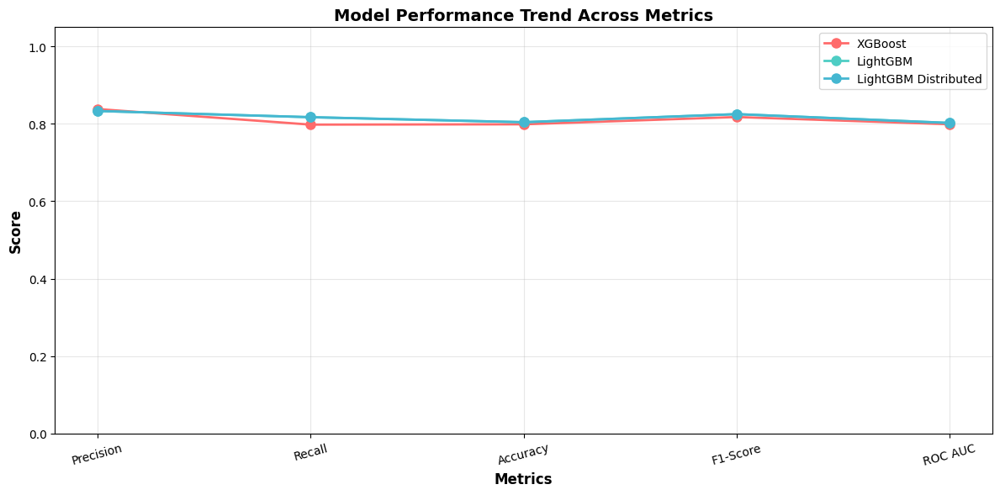

In [90]:
# Individual metrics line plot
fig, ax = plt.subplots(figsize=(12, 6))
x_pos = np.arange(len(metrics))
colors = ['#FF6B6B', '#4ECDC4', '#45B7D1']

for idx, model in enumerate(results.keys()):
    values = [results[model][metric] for metric in metrics]
    
    ax.plot(x_pos, values, marker='o', label=model, linewidth=2, markersize=8, color=colors[idx])

ax.set_xlabel('Metrics', fontweight='bold', fontsize=12)
ax.set_ylabel('Score', fontweight='bold', fontsize=12)
ax.set_title('Model Performance Trend Across Metrics', fontsize=14, fontweight='bold')
ax.set_xticks(x_pos)
ax.set_xticklabels(metrics, rotation=15)
ax.set_ylim([0, 1.05])
ax.legend(fontsize=10)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

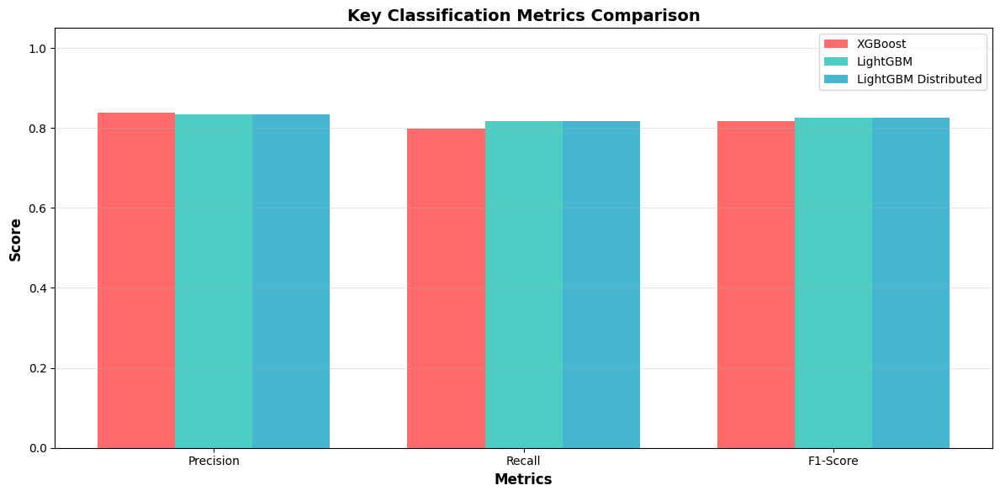

In [91]:
# Grouped bar chart for key metrics
fig, ax = plt.subplots(figsize=(12, 6))
key_metrics = ['Precision', 'Recall', 'F1-Score']
x_pos = np.arange(len(key_metrics))
width = 0.25
colors = ['#FF6B6B', '#4ECDC4', '#45B7D1']

for idx, model in enumerate(results.keys()):
    values = [results[model][metric] for metric in key_metrics]
    
    ax.bar(x_pos + idx * width, values, width, label=model, color=colors[idx])

ax.set_xlabel('Metrics', fontweight='bold', fontsize=12)
ax.set_ylabel('Score', fontweight='bold', fontsize=12)
ax.set_title('Key Classification Metrics Comparison', fontsize=14, fontweight='bold')
ax.set_xticks(x_pos + width)
ax.set_xticklabels(key_metrics)
ax.set_ylim([0, 1.05])
ax.legend(fontsize=10)
ax.grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()

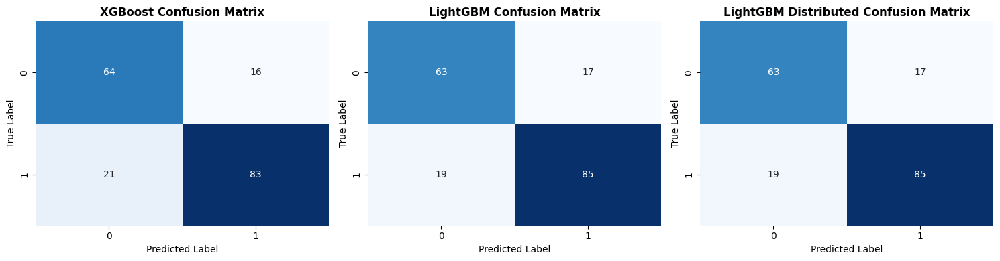

In [92]:
# Confusion matrices
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

cm_xgb = confusion_matrix(y_test, y_pred_xgb)
cm_lgb = confusion_matrix(y_test, y_pred_lgb)
cm_lgb_dist = confusion_matrix(y_test, y_pred_lgb_dist)

cms = [cm_xgb, cm_lgb, cm_lgb_dist]
titles = ['XGBoost', 'LightGBM', 'LightGBM Distributed']

for idx, (cm, title) in enumerate(zip(cms, titles)):
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[idx], cbar=False)
    
    axes[idx].set_title(f'{title} Confusion Matrix', fontweight='bold')
    axes[idx].set_ylabel('True Label')
    axes[idx].set_xlabel('Predicted Label')

plt.tight_layout()
plt.show()

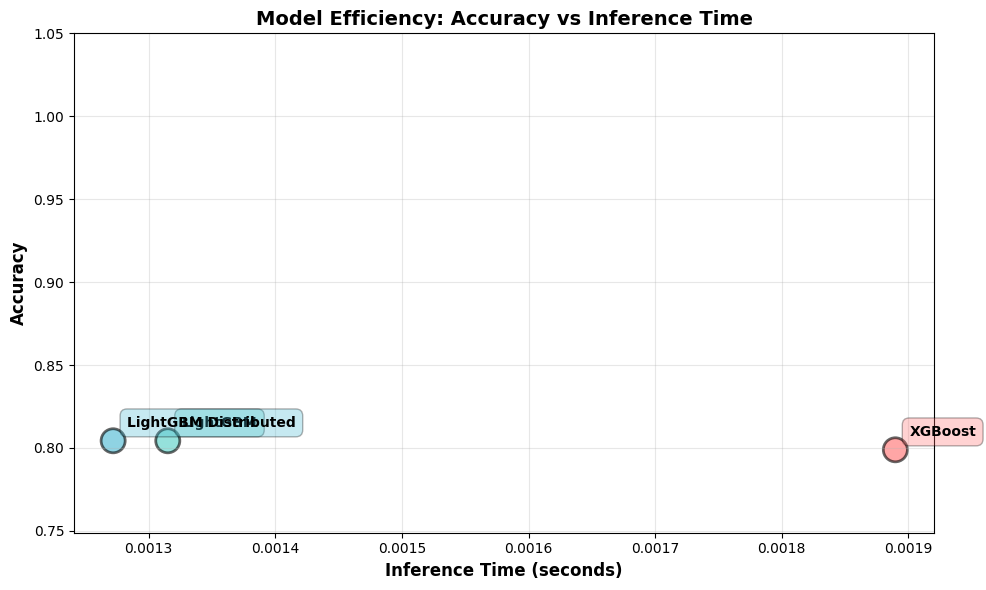

In [93]:
# Model efficiency (accuracy vs inference time)
fig, ax = plt.subplots(figsize=(10, 6))
colors = ['#FF6B6B', '#4ECDC4', '#45B7D1']

model_names = list(results.keys())
accuracies = [results[model]['Accuracy'] for model in model_names]
times = [results[model]['Inference Time (s)'] for model in model_names]

scatter = ax.scatter(times, accuracies, s=300, c=colors, alpha=0.6, edgecolors='black', linewidth=2)

for i, model in enumerate(model_names):
    ax.annotate(
        model,
        (times[i], accuracies[i]),
        xytext=(10, 10),
        textcoords='offset points',
        fontsize=10,
        fontweight='bold',
        bbox=dict(boxstyle='round,pad=0.5', facecolor=colors[i], alpha=0.3),
    )

ax.set_xlabel('Inference Time (seconds)', fontweight='bold', fontsize=12)
ax.set_ylabel('Accuracy', fontweight='bold', fontsize=12)
ax.set_title('Model Efficiency: Accuracy vs Inference Time', fontsize=14, fontweight='bold')
ax.grid(True, alpha=0.3)
ax.set_ylim([min(accuracies) - 0.05, 1.05])

plt.tight_layout()
plt.show()

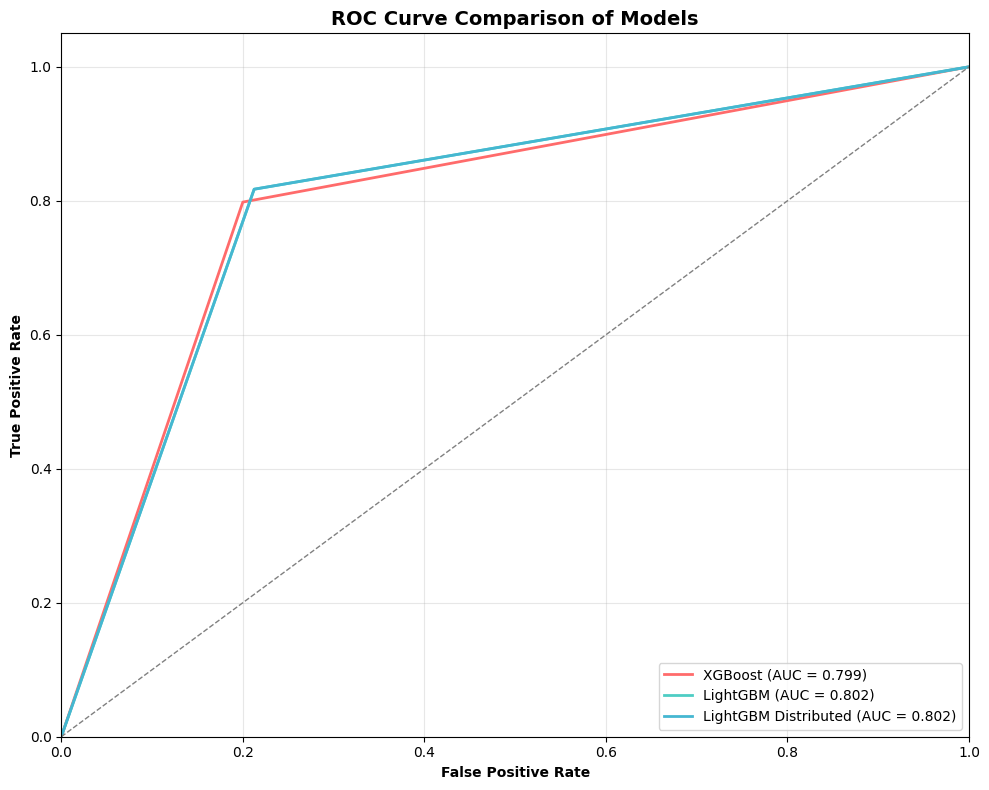

In [ ]:
# ROC Curves Comparison of the Models
plt.figure(figsize=(10, 8))

# XGBoost ROC curve
fpr_xgb, tpr_xgb, _ = roc_curve(y_test, y_pred_xgb)
roc_auc_xgb = auc(fpr_xgb, tpr_xgb)
plt.plot(fpr_xgb, tpr_xgb, color=colors[0], lw=2, label=f'XGBoost (AUC = {roc_auc_xgb:.3f})')

# LightGBM ROC curve
fpr_lgb, tpr_lgb, _ = roc_curve(y_test, y_pred_lgb)
roc_auc_lgb = auc(fpr_lgb, tpr_lgb)
plt.plot(fpr_lgb, tpr_lgb, color=colors[1], lw=2, label=f'LightGBM (AUC = {roc_auc_lgb:.3f})')

# LightGBM Distributed ROC curve
fpr_lgb_dist, tpr_lgb_dist, _ = roc_curve(y_test, y_pred_lgb_dist)
roc_auc_lgb_dist = auc(fpr_lgb_dist, tpr_lgb_dist)
plt.plot(fpr_lgb_dist, tpr_lgb_dist, color=colors[2], lw=2, label=f'LightGBM Distributed (AUC = {roc_auc_lgb_dist:.3f})')

plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontweight='bold')
plt.ylabel('True Positive Rate', fontweight='bold')
plt.title('ROC Curve Comparison of Models', fontsize=14, fontweight='bold')
plt.legend(loc='lower right')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [94]:
# Ranking analysis
print("" + "=" * 80)
print("MODEL RANKING ANALYSIS")
print("=" * 80)

for metric in metrics + ['Inference Time (s)']:
    print(f"{metric} Rankings:")

    metric_values = [(model, results[model][metric]) for model in results.keys()]
    
    if metric == 'Inference Time (s)':
        metric_values.sort(key=lambda x: x[1])
        print("(Lower is Better)")

    else:
        metric_values.sort(key=lambda x: x[1], reverse=True)
        print("(Higher is Better)")

    for rank, (model, value) in enumerate(metric_values, 1):
        print(f"  {rank}. {model}: {value:.4f}")
              
print("" + "=" * 80)
print("OVERALL MODEL RANKING (Average Performance Across All Metrics)")
print("=" * 80)

overall_ranks = {model: [] for model in results.keys()}

for metric in metrics + ['Inference Time (s)']:
    metric_values = [(model, results[model][metric]) for model in results.keys()]

    if metric == 'Inference Time (s)':
        metric_values.sort(key=lambda x: x[1])

    else:
        metric_values.sort(key=lambda x: x[1], reverse=True)

    for rank, (model, _) in enumerate(metric_values, 1):
        overall_ranks[model].append(rank)
                                    
avg_ranks = {model: np.mean(ranks) for model, ranks in overall_ranks.items()}
sorted_models = sorted(avg_ranks.items(), key=lambda x: x[1])
                       
for rank, (model, avg_rank) in enumerate(sorted_models, 1):
    print(f"{rank}. {model}: Average Rank = {avg_rank:.2f}")

print("\n" + "=" * 60)
print("Evaluation Complete")
print("=" * 60)

MODEL RANKING ANALYSIS
Precision Rankings:
(Higher is Better)
  1. XGBoost: 0.8384
  2. LightGBM: 0.8333
  3. LightGBM Distributed: 0.8333
Recall Rankings:
(Higher is Better)
  1. LightGBM: 0.8173
  2. LightGBM Distributed: 0.8173
  3. XGBoost: 0.7981
Accuracy Rankings:
(Higher is Better)
  1. LightGBM: 0.8043
  2. LightGBM Distributed: 0.8043
  3. XGBoost: 0.7989
F1-Score Rankings:
(Higher is Better)
  1. LightGBM: 0.8252
  2. LightGBM Distributed: 0.8252
  3. XGBoost: 0.8177
ROC AUC Rankings:
(Higher is Better)
  1. LightGBM: 0.8024
  2. LightGBM Distributed: 0.8024
  3. XGBoost: 0.7990
Inference Time (s) Rankings:
(Lower is Better)
  1. LightGBM Distributed: 0.0013
  2. LightGBM: 0.0013
  3. XGBoost: 0.0019
OVERALL MODEL RANKING (Average Performance Across All Metrics)
1. LightGBM: Average Rank = 1.33
2. LightGBM Distributed: Average Rank = 2.00
3. XGBoost: Average Rank = 2.67

Evaluation Complete


### **SHAP Explainations of both Gradient Boosting Models**

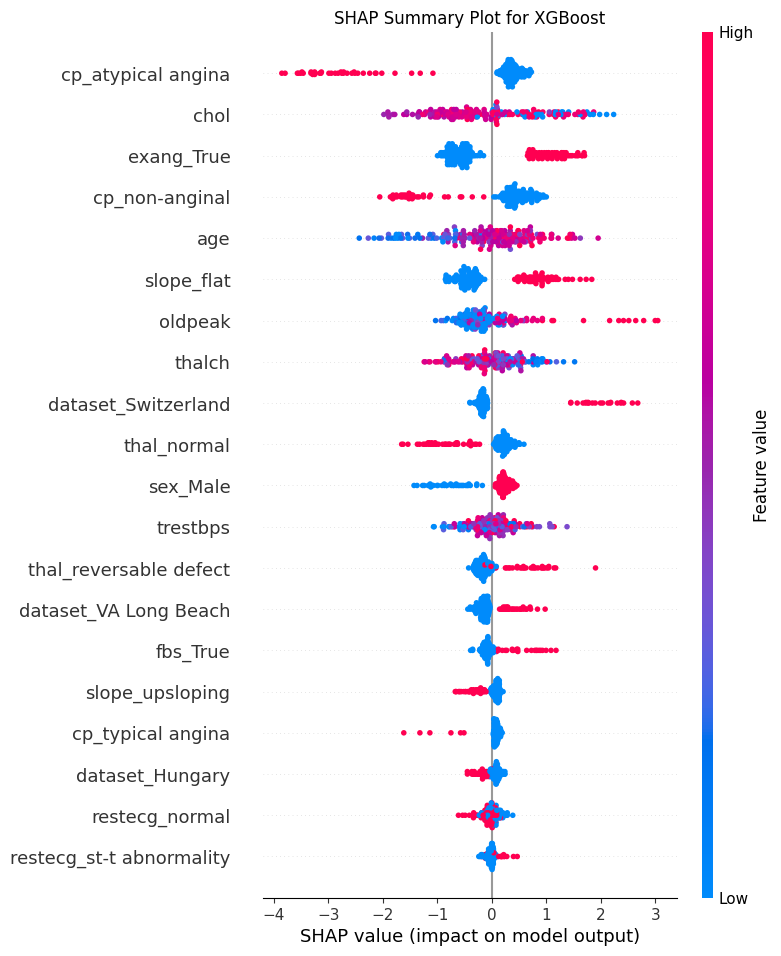

In [95]:
# SHAP explanation for XGBoost model
explainer_xgb = shap.TreeExplainer(xgb_clf) # setup SHAP tree explainer for the xgboost model
shap_values_xgb = explainer_xgb.shap_values(X_test.values) # compute SHAP values for the xgboost model using the testing data of the heart disease dataset

shap.summary_plot(shap_values_xgb, X_test, show=False) # summary plot the calculated SHAP values for the xgboost model

plt.title('SHAP Summary Plot for XGBoost')

plt.show() # output SHAP summary plot for the xgboost model

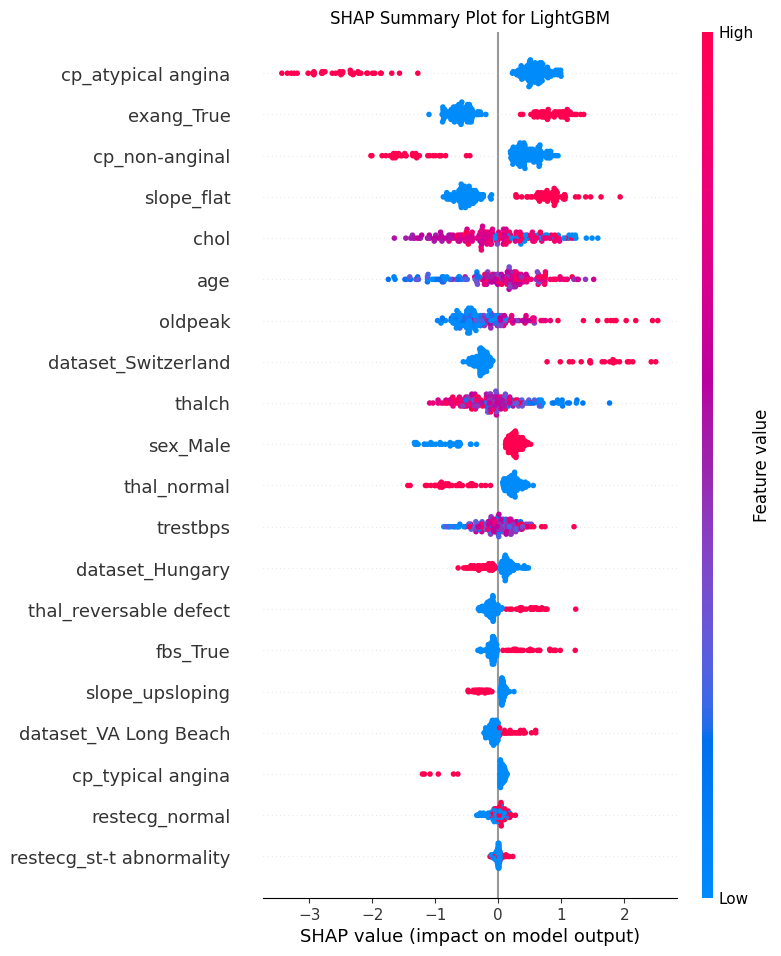

In [96]:
# SHAP explanation for non-distributed LightGBM
explainer_lgb = shap.TreeExplainer(lgb_clf) # setup SHAP tree explainer for the non-distributed lightgbm model
shap_values_lgb = explainer_lgb.shap_values(X_test.values) # compute SHAP values for the non-distributed lightgbm model using the testing data of the heart disease dataset

shap.summary_plot(shap_values_lgb, X_test, show=False) # summary plot the calculated SHAP values for the non-distributed lightgbm model

plt.title('SHAP Summary Plot for LightGBM')

plt.show() # output SHAP summary plot for the non-distributed lightgbm model

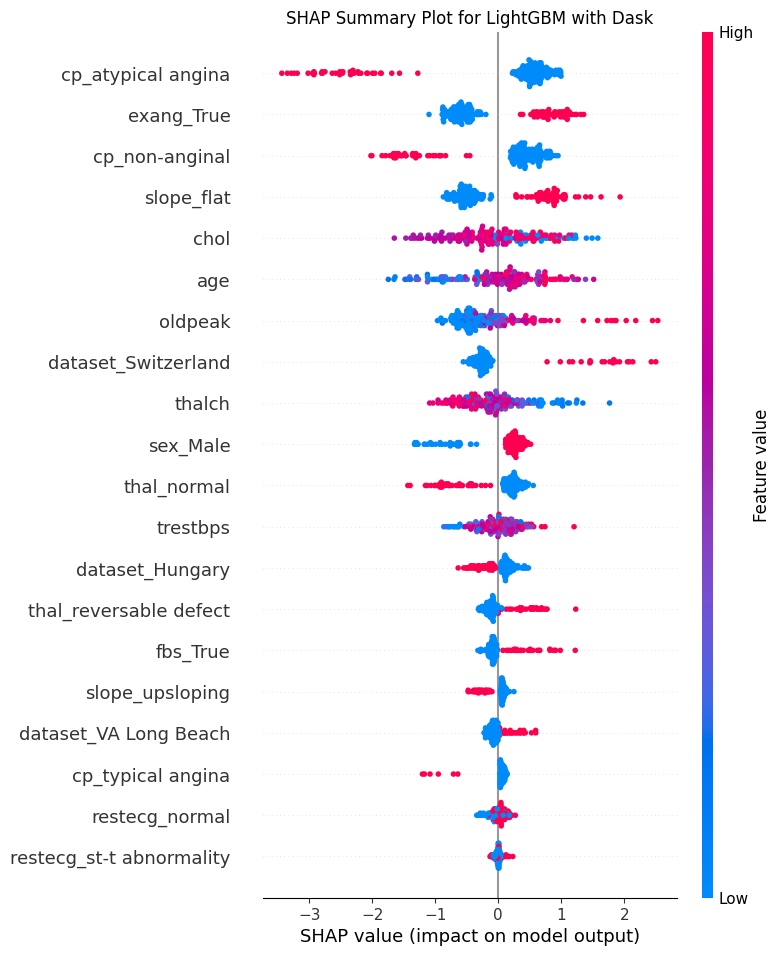

In [97]:
# SHAP explanation for LightGBM with Dask Distributed Learning
explainer_lgb_dist = shap.TreeExplainer(lgb_dist_clf) # setup SHAP tree explainer for the lightgbm model trained with dask distributed learning
shap_values_lgb_dist = explainer_lgb_dist.shap_values(X_test.values) # compute SHAP values for the lightgbm model trained with dask distributed learning using the testing data of the heart disease dataset

shap.summary_plot(shap_values_lgb_dist, X_test, show=False) # plot the calculated SHAP values for the lightgbm model trained with dask distributed learning

plt.title('SHAP Summary Plot for LightGBM with Dask')

plt.show() # output SHAP summary plot for the lightgbm model trained with dask distributed learning

In [98]:
# Comparative Analysis: LightGBM (Tree-Based) vs Logistic Regression (Linear Model)
print("Comparing SHAP explainaination of the LightGBM vs a non-tree-based LR Model")

# Train Logistic Regression for comparison
log_reg_clf = LogisticRegression(max_iter=1000, random_state=42)
log_reg_clf.fit(X_train, y_train)

y_pred_log_reg = log_reg_clf.predict(X_test)

print("\nLogistic Regression Performance:")
print(f"Accuracy: {accuracy_score(y_test, y_pred_log_reg):.4f}")
print(f"F1-Score: {f1_score(y_test, y_pred_log_reg):.4f}")

Comparing SHAP explainaination of the LightGBM vs a non-tree-based LR Model

Logistic Regression Performance:
Accuracy: 0.8207
F1-Score: 0.8436


In [99]:
# SHAP explanations and handling for Logistic Regression
explainer_log_reg = shap.LinearExplainer(log_reg_clf, X_train)
shap_values_log_reg = explainer_log_reg.shap_values(X_test)

# Handle LightGBM SHAP values format (may be list of arrays for binary classification)
if isinstance(shap_values_lgb, list):
    shap_values_lgb_plot = shap_values_lgb[1]  # Use positive class

else:
    shap_values_lgb_plot = shap_values_lgb

# Robust handling for Logistic Regression SHAP values
shap_log_raw = shap_values_log_reg

if isinstance(shap_log_raw, list):
    shap_values_log_reg_plot = np.array(shap_log_raw[1] if len(shap_log_raw) > 1 else shap_log_raw[0])

else:
    shap_values_log_reg_plot = np.array(shap_log_raw)

# Normalize shape to (n_samples, n_features)
if shap_values_log_reg_plot.ndim == 1:

    if shap_values_log_reg_plot.shape[0] == X_test.shape[1]:
        shap_values_log_reg_plot = np.tile(shap_values_log_reg_plot, (X_test.shape[0], 1))

    else:
        shap_values_log_reg_plot = shap_values_log_reg_plot.reshape(-1, 1)

elif shap_values_log_reg_plot.ndim == 2 and shap_values_log_reg_plot.shape[1] == 1 and X_test.shape[1] > 1:
    shap_values_log_reg_plot = np.tile(shap_values_log_reg_plot, (1, X_test.shape[1]))

shap_values_log_reg_plot = shap_values_log_reg_plot.astype(float, copy=False)

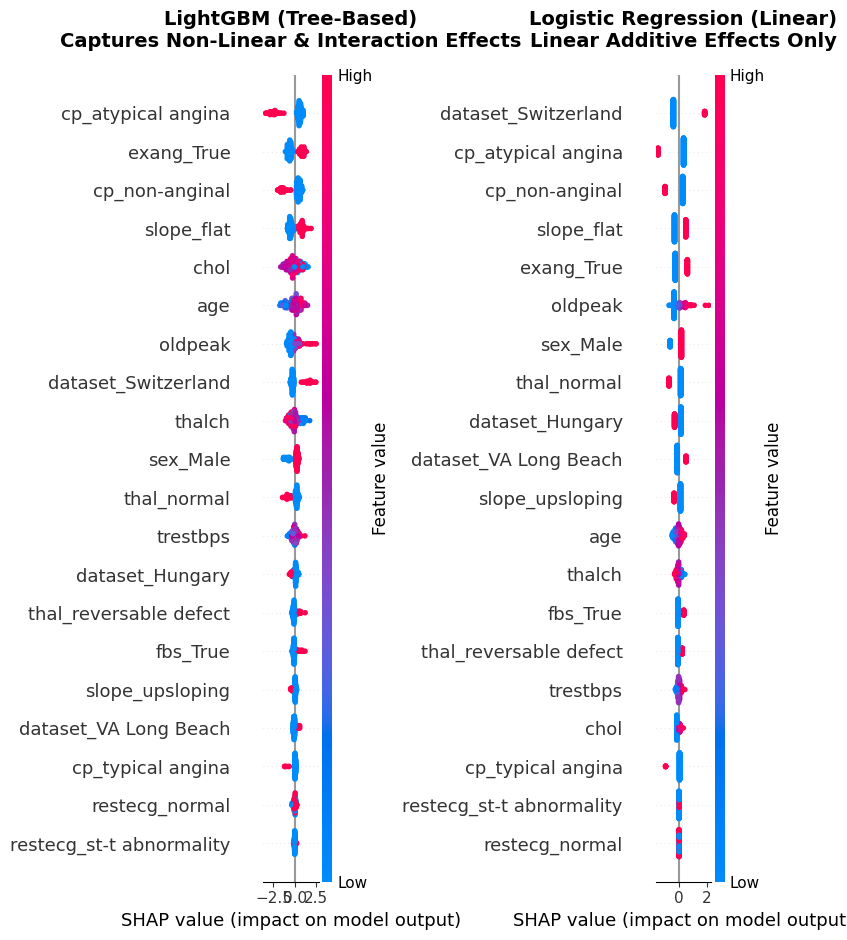

In [100]:
# Side-by-side SHAP comparison
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

plt.sca(axes[0])
shap.summary_plot(shap_values_lgb_plot, X_test, show=False)

axes[0].set_title('LightGBM (Tree-Based)\nCaptures Non-Linear & Interaction Effects',fontsize=14, fontweight='bold', pad=20)

plt.sca(axes[1])
shap.summary_plot(shap_values_log_reg_plot, X_test, show=False)

axes[1].set_title('Logistic Regression (Linear)\nLinear Additive Effects Only',fontsize=14, fontweight='bold', pad=20)

plt.tight_layout()
plt.show()

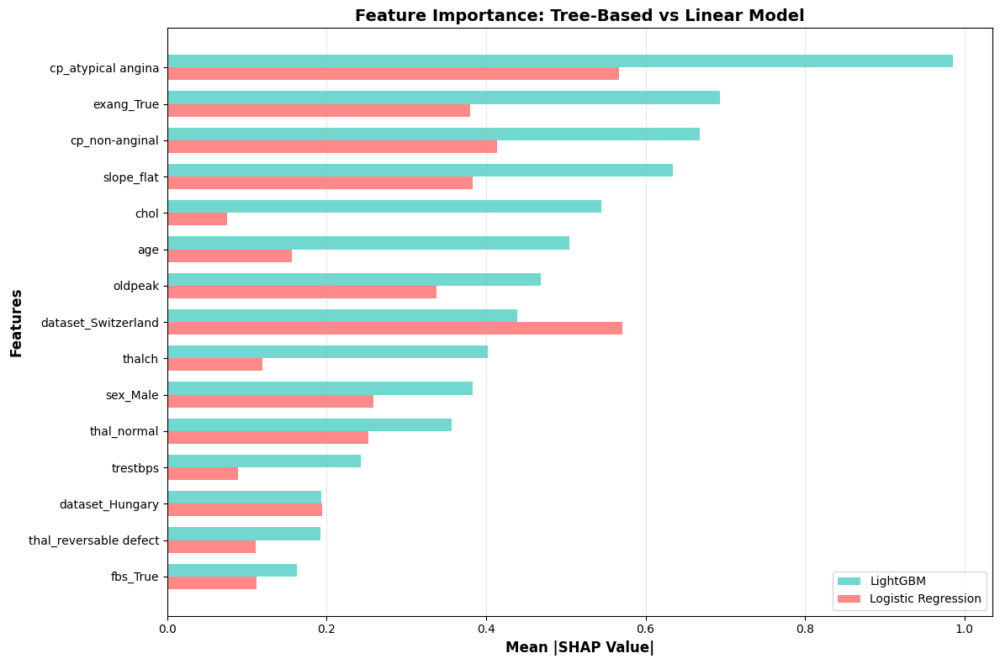

In [101]:
# Feature importance comparison and key differences
lgb_importance = np.abs(shap_values_lgb_plot).mean(axis=0)
log_reg_importance = np.abs(shap_values_log_reg_plot).mean(axis=0)

comparison_df = pd.DataFrame({
    'Feature': X_test.columns,
    'LightGBM': lgb_importance,
    'LogReg': log_reg_importance
}).sort_values('LightGBM', ascending=False).head(15)

fig, ax = plt.subplots(figsize=(12, 8))
x_pos = np.arange(15)
width = 0.35

bars1 = ax.barh(x_pos - width/2, comparison_df['LightGBM'], width, label='LightGBM', color='#4ECDC4', alpha=0.8)
bars2 = ax.barh(x_pos + width/2, comparison_df['LogReg'], width, label='Logistic Regression', color='#FF6B6B', alpha=0.8)

ax.set_xlabel('Mean |SHAP Value|', fontweight='bold', fontsize=12)
ax.set_ylabel('Features', fontweight='bold', fontsize=12)
ax.set_title('Feature Importance: Tree-Based vs Linear Model', fontsize=14, fontweight='bold')
ax.set_yticks(x_pos)
ax.set_yticklabels(comparison_df['Feature'])
ax.legend()
ax.invert_yaxis()
ax.grid(True, alpha=0.3, axis='x')

plt.tight_layout()
plt.show()